In [115]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

import pandas as pd

In [116]:

df = pd.read_csv("./preprocessed.csv")

df = df[df['Stars']!=5].reset_index(drop=True)

df['Cleaned Reviews'] = df['Cleaned Reviews'].fillna("")
cleaned_docs = df['Cleaned Reviews']

print(cleaned_docs)


0        May stop work every time click wait wait nothi...
1                close account day create refuse elaborate
2           constantly freeze phone work well samsung fold
3        horrible experience spend min login correct datum
4        app never let first time always log get dump c...
                               ...                        
47840    would nice option mailing address separate phy...
47841          great bank great staff great account option
47842    occasional issue auto picture take deposit use...
47843         complaint pretty regularly app fine ever use
47844                                   enjoy redesign app
Name: Cleaned Reviews, Length: 47845, dtype: object


In [117]:

vectorizer = TfidfVectorizer(
    lowercase=True,
    max_features=100,
    max_df= 0.8,
    min_df=5,
    ngram_range=(1,3),
    stop_words='english'
)


In [118]:

vectors = vectorizer.fit_transform(cleaned_docs)


In [119]:
print(vectors[0])

  (0, 80)	0.41038877874862245
  (0, 97)	0.4835825988567591
  (0, 85)	0.2539879549750042
  (0, 64)	0.3496910626397998
  (0, 44)	0.41897627453042763
  (0, 89)	0.2646500770687786
  (0, 4)	0.1635090908689777
  (0, 5)	0.37231598822628287


In [120]:
feature_names = vectorizer.get_feature_names_out()

In [121]:
print (feature_names[0])


able


In [122]:
dense = vectors.todense()

In [123]:
print(dense[0])

[[0.         0.         0.         0.         0.16350909 0.37231599
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.41897627 0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.34969106 0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.41038878 0.         0.         0.
  0.         0.25398795 0.         0.         0.         0.26465008
  0.         0.         0.         0.         0.         0.
  0.         0.4835826  

In [124]:
denseList = dense.tolist()

In [125]:
all_keywords =[]
for description in denseList:
    x=0
    keywords=[]
    for word in description:
        if word > 0:
            keywords.append(feature_names[x])
        x=x+1
    all_keywords.append(keywords)


In [126]:
print(all_keywords[1])
print(cleaned_docs[1])

['account', 'close', 'day']
close account day create refuse elaborate


In [ ]:
true_k = 8
model = KMeans(n_clusters=true_k,init = "k-means++",max_iter=100,n_init=1)


In [128]:
model.fit(vectors)

KMeans(max_iter=100, n_init=1)

In [129]:
order_centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names_out()


In [130]:
print (order_centroids)


[[69 18  4 60 89 51 90 73 97 62 27 98 59  9 91 61 53 85 34 88 13 82 49 56
   1  2 10 23 70 46 45 64 42 15 75 33 43 37  0 26 36 50  5 71 39 80 25 57
   6 94 72 66 95 67  3 35 74 48 81 76 63 44 84 20 79 77 55 12  7 58 41 83
  93 96 65 11 47 16 38 52 17 30 68 24 19 78 28 31 99 92 87 29 40  8 86 14
  54 32 21 22]
 [90  4 28 91 85 89 97 88 49 53 66  2 36 37 99 46 98 50 59 34 95 45 73 51
  26 11 56 77 15 29  7 31 42 10  0 20 38 13 71 67 69 70  9 74 76 72  3 58
  64 33 80 57 60 35 82  8 94 12 48 68 96 19 27  1 62 63 25 92 86 65 30 47
  16  6 84 41 23 55 21 75 61 78 79 40 87 83 39 44 43 17 81  5 54 14 52 24
  93 18 32 22]
 [ 2 36 85 49 89 68 53 26 59 88 15 67 76 46 57 77 42 23 66 73  4 25 50 28
  78 13 81  8 45 32 38 86 37 70  7 64 92 99 47  1 34 58 87 24 75 14 29 51
  94 82 60 54 40  0 83 11 20 39 65 56 84 10 30 98 44 41 43 63 79  3 17  6
  16 48 97 71 74 31 35 19 80 55 96 61 52 95 33 90  9 62 21 27 69 72 12 93
  18  5 91 22]
 [12 21 22 67 68  2  4 90 14 53 32 88  8 85  9 46 17 25  7 60 48 57

In [131]:
print(terms[90])

use


In [132]:
i = 0
for cluster in order_centroids:
    print(f"Cluster {i}")
    for keywords in cluster[0:10]:
        print(terms[keywords])
    print("")
    i=i+1

Cluster 0
phone
compatible
app
new
update
long
use
say
work
old

Cluster 1
use
app
easy
use app
time
update
work
try
log
make

Cluster 2
account
good
time
log
update
payment
make
deposit
need
try

Cluster 3
card
credit
credit card
pay
payment
account
app
use
charge
make

Cluster 4
want
app
account
make
update
time
use
need
work
log

Cluster 5
bank
account
app
money
bad
time
check
deposit
use
customer

Cluster 6
app
update
time
log
open
fix
try
crash
login
issue

Cluster 7
work
app work
app
time
update
need
log
fine
deposit
biometric



In [137]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA


In [138]:
def predict(size):
    true_k = 8
    model = KMeans(n_clusters=true_k,init = "k-means++",max_iter=100,n_init=1)
    model.fit(vectors)
    order_centroids = model.cluster_centers_.argsort()[:, ::-1]
    terms = vectorizer.get_feature_names_out()
    i = 0
    for cluster in order_centroids:
        print(f"Cluster {i}")
        for keywords in cluster[0:10]:
            print(terms[keywords])
        print("")
        i=i+1
    kmean_indices = model.fit_predict(vectors)

    pca = PCA(n_components=2)
    scatter_plot_points = pca.fit_transform(vectors.toarray())

    x_axis = [o[0] for o in scatter_plot_points]
    y_axis = [o[1] for o in scatter_plot_points]

    num_clusters = len(set(kmean_indices))
    colors = sns.color_palette("hsv", num_clusters)

    fig, ax = plt.subplots(figsize=(50, 50))
    ax.scatter(x_axis, y_axis, c=[colors[d] for d in kmean_indices])
    fig.savefig(f"kmeans_clusters_clusters_{size}.png")

Cluster 0
bank
account
app
money
bad
use
check
time
deposit
customer

Cluster 1
account
time
log
update
use
payment
make
easy
deposit
need

Cluster 2
app
update
use
time
log
open
fix
try
crash
login

Cluster 3
phone
compatible
app
new
update
use
long
say
work
old

Cluster 4
suck
app
bank
account
time
log
password
work
update
money

Cluster 5
work
app work
app
time
update
fine
need
log
try
deposit

Cluster 6
good
app
use
service
experience
bank
work
time
easy
update

Cluster 7
card
credit
credit card
pay
payment
use
app
account
charge
make

Cluster 0
update
app
phone
new
log
work
need
use
say
time

Cluster 1
bank
account
app
money
bad
check
time
use
deposit
customer

Cluster 2
use
app
use app
easy
phone
time
card
try
work
year

Cluster 3
good
app
service
bank
use
work
experience
time
need
card

Cluster 4
app
time
phone
open
log
fix
try
login
crash
banking

Cluster 5
account
time
card
log
payment
make
deposit
try
need
check

Cluster 6
pay
card
payment
credit
account
app
day
make
fee
bala

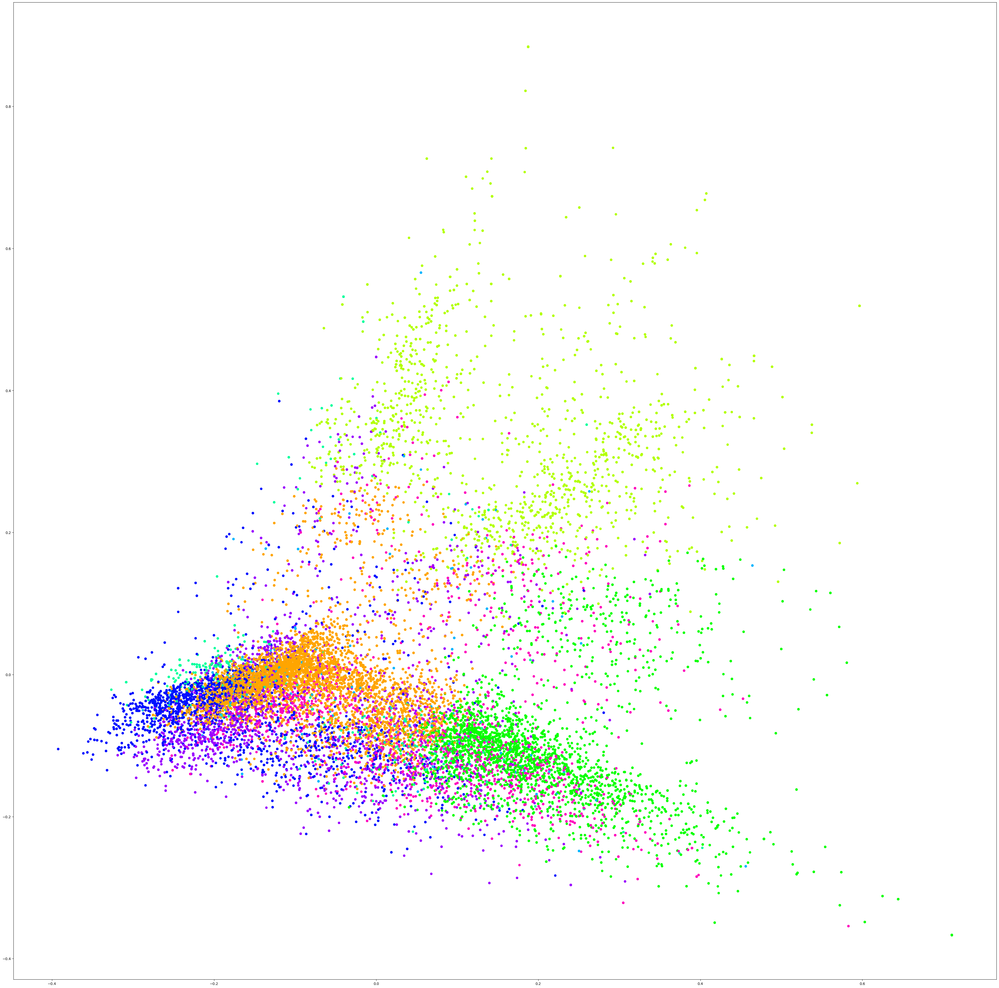

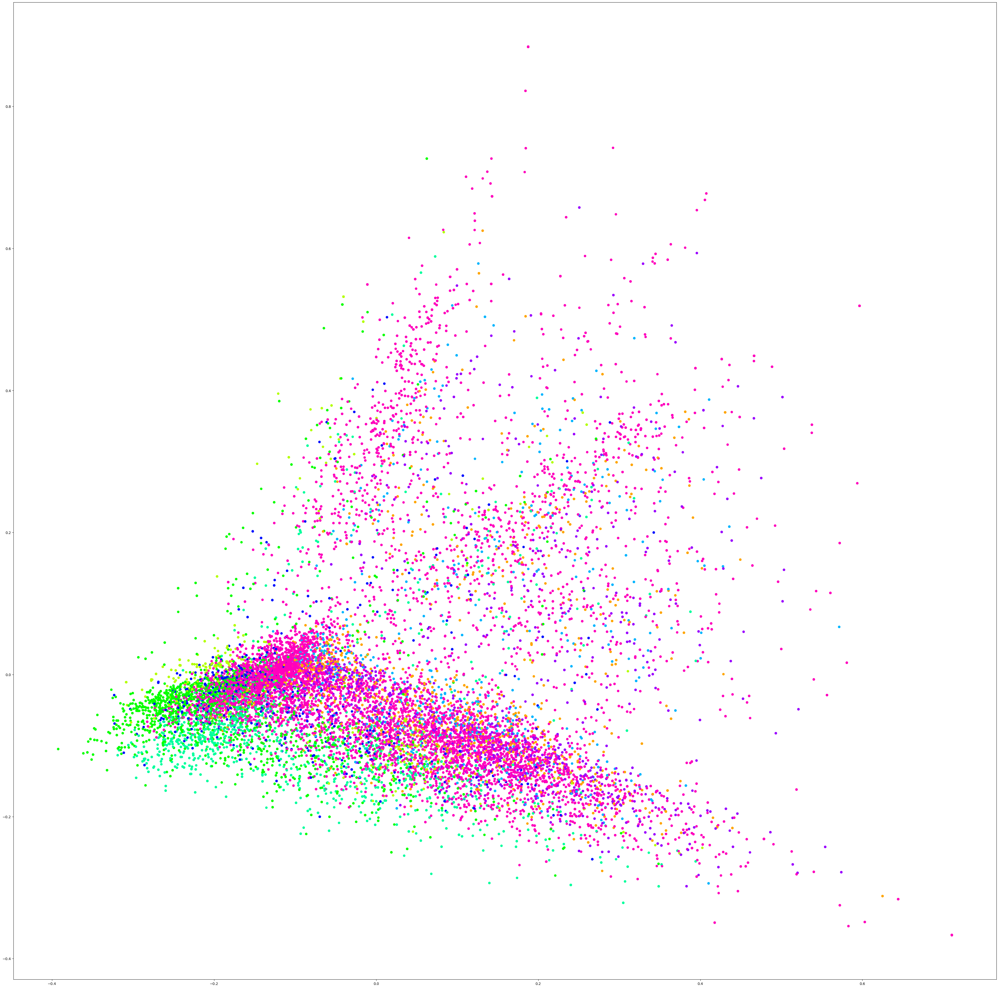

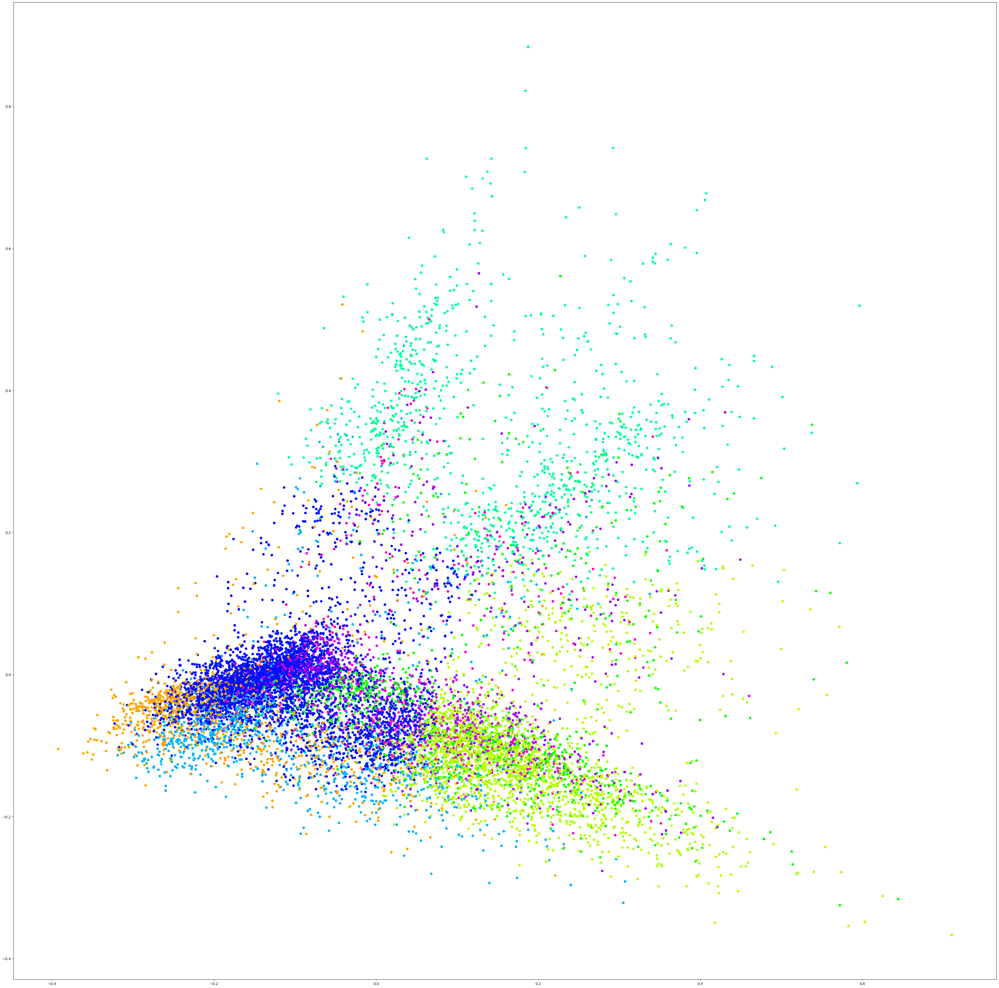

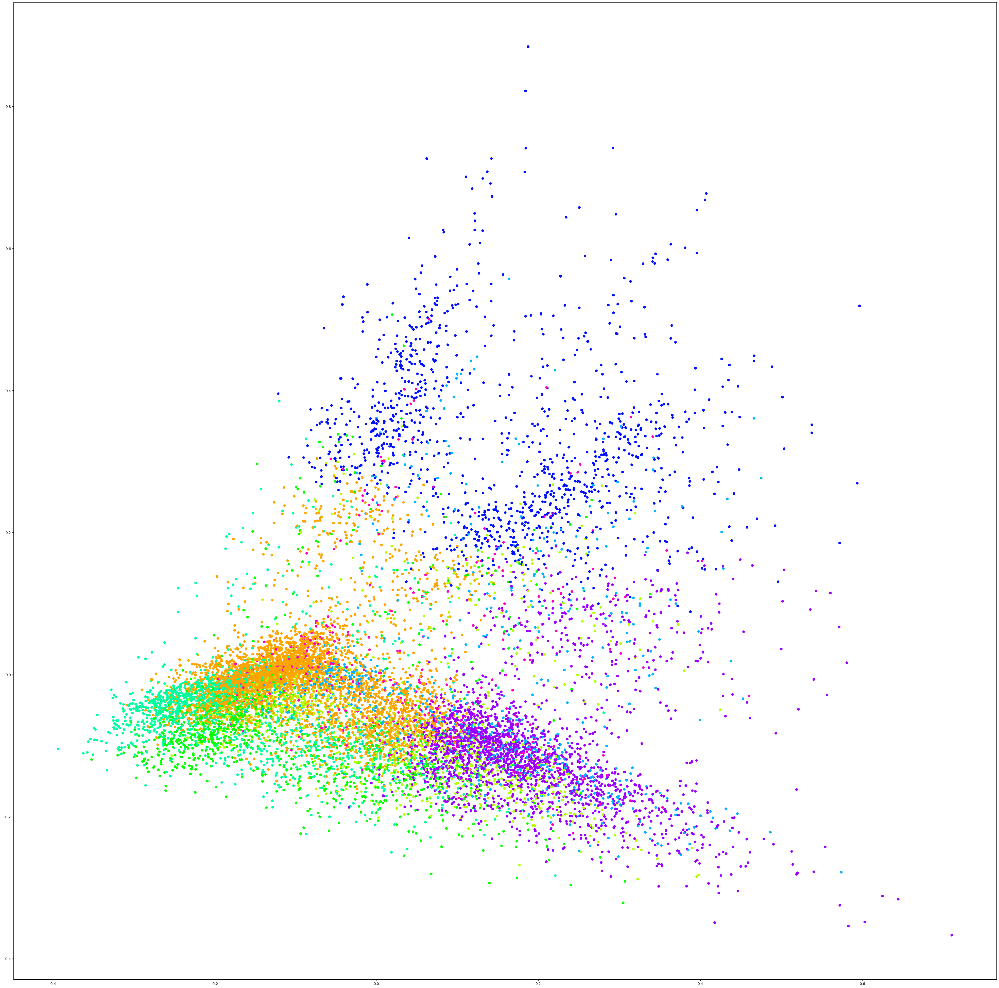

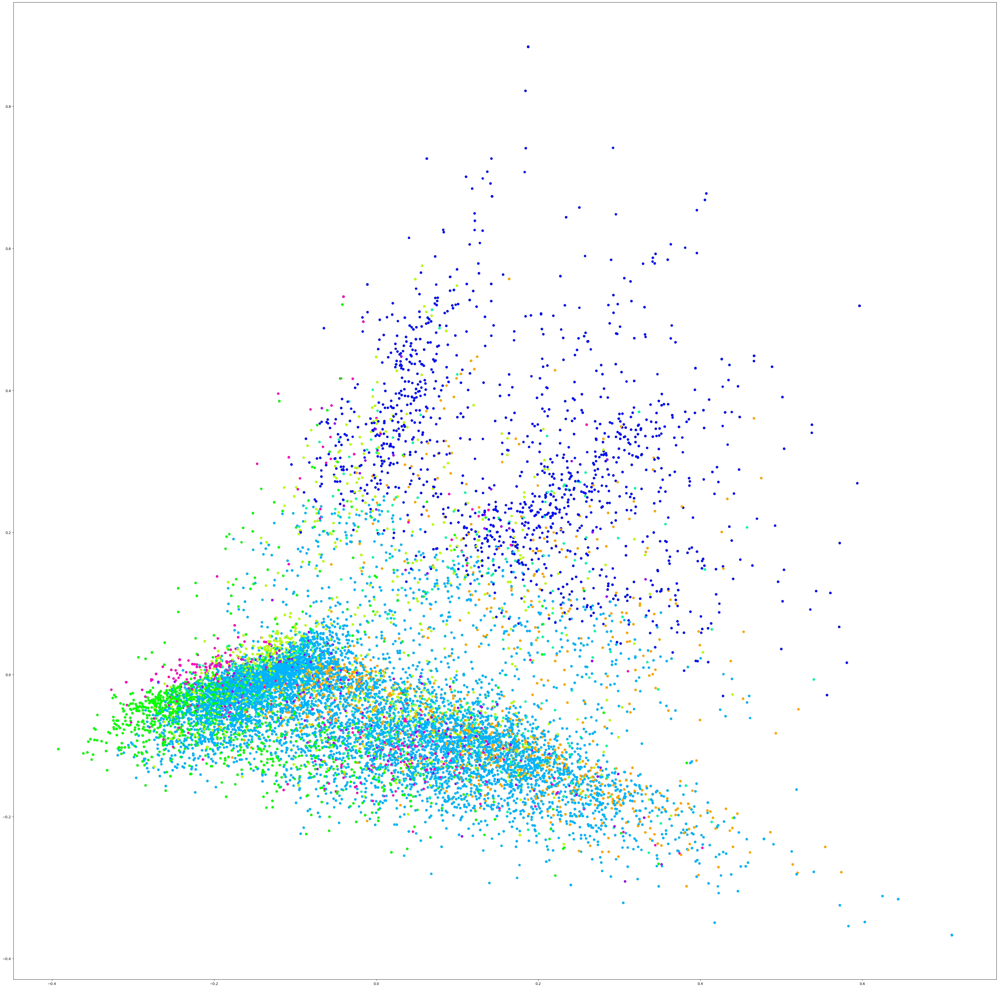

...

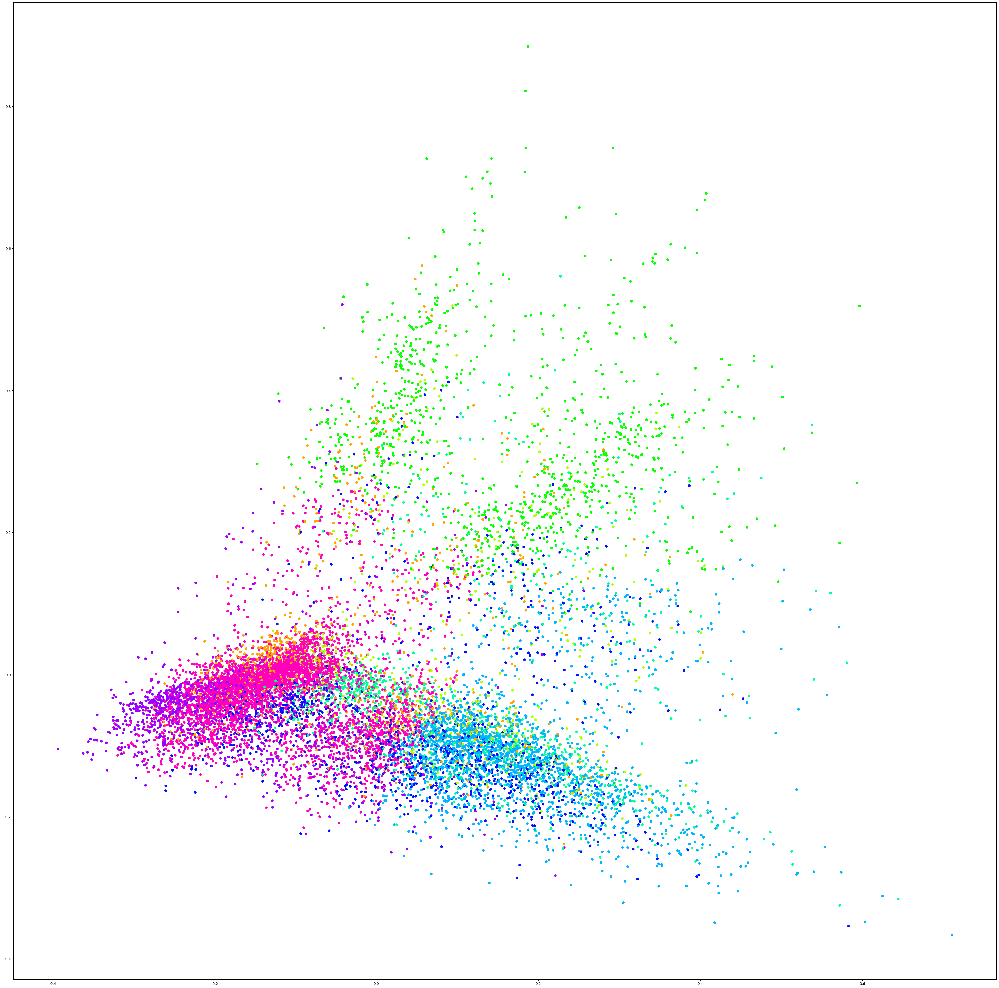

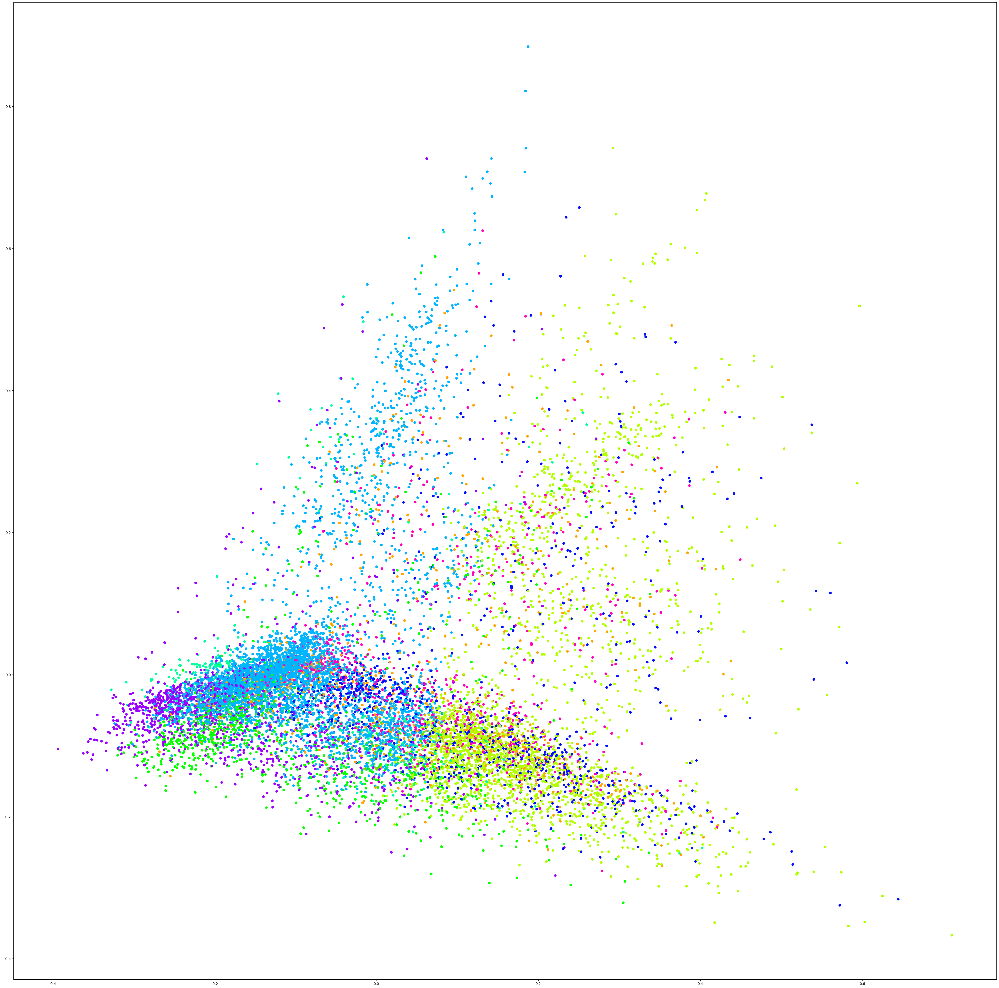

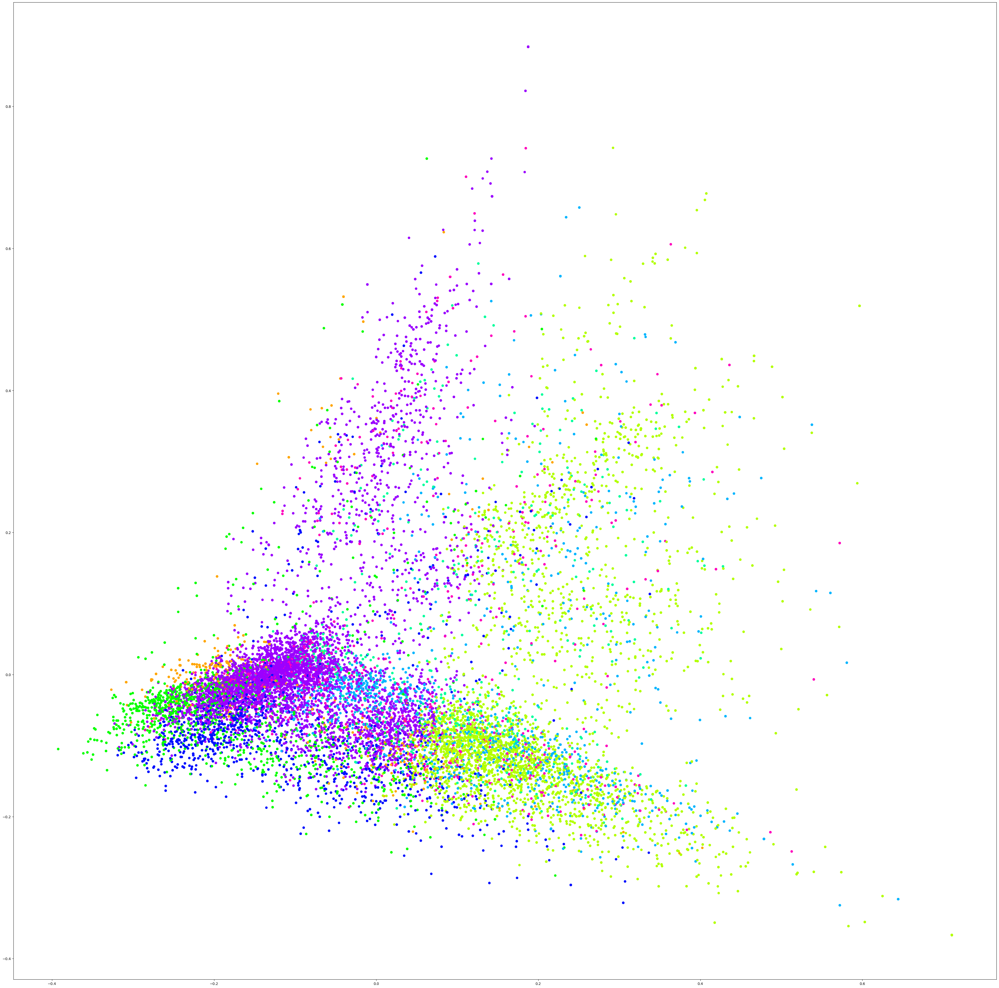

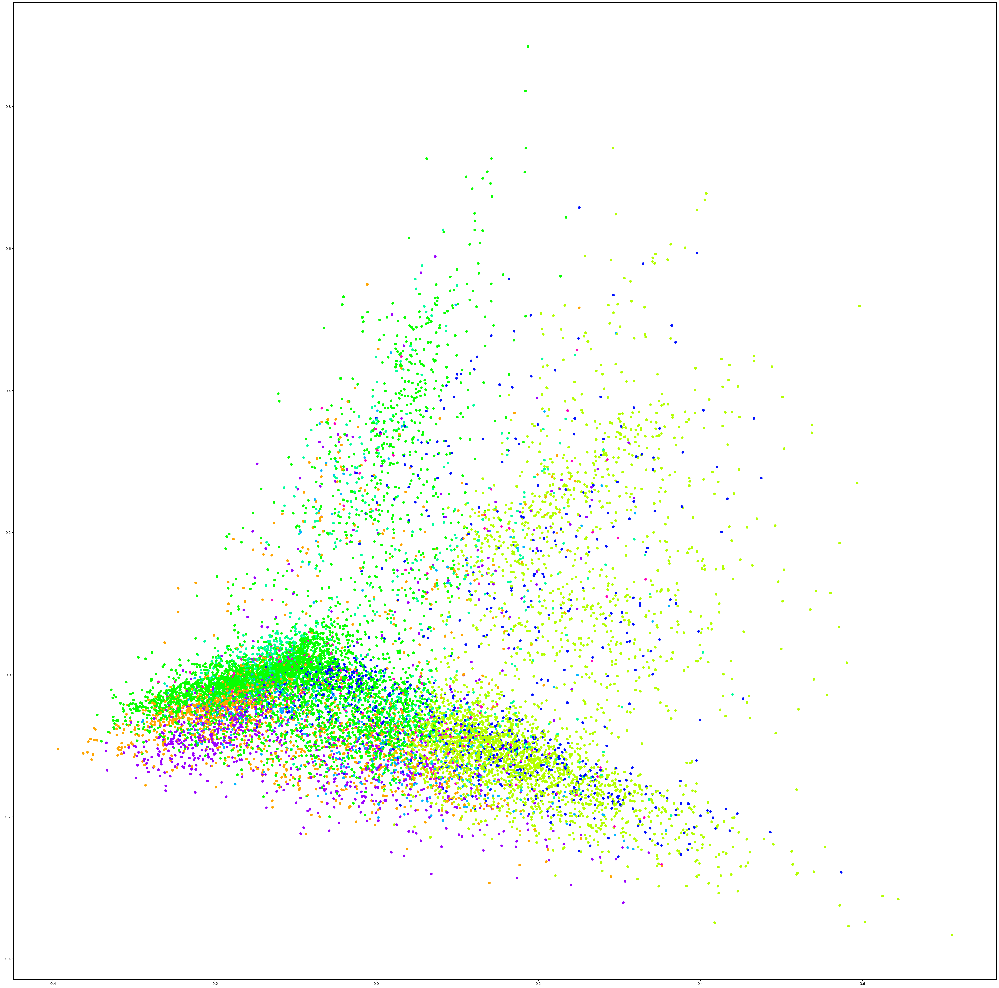

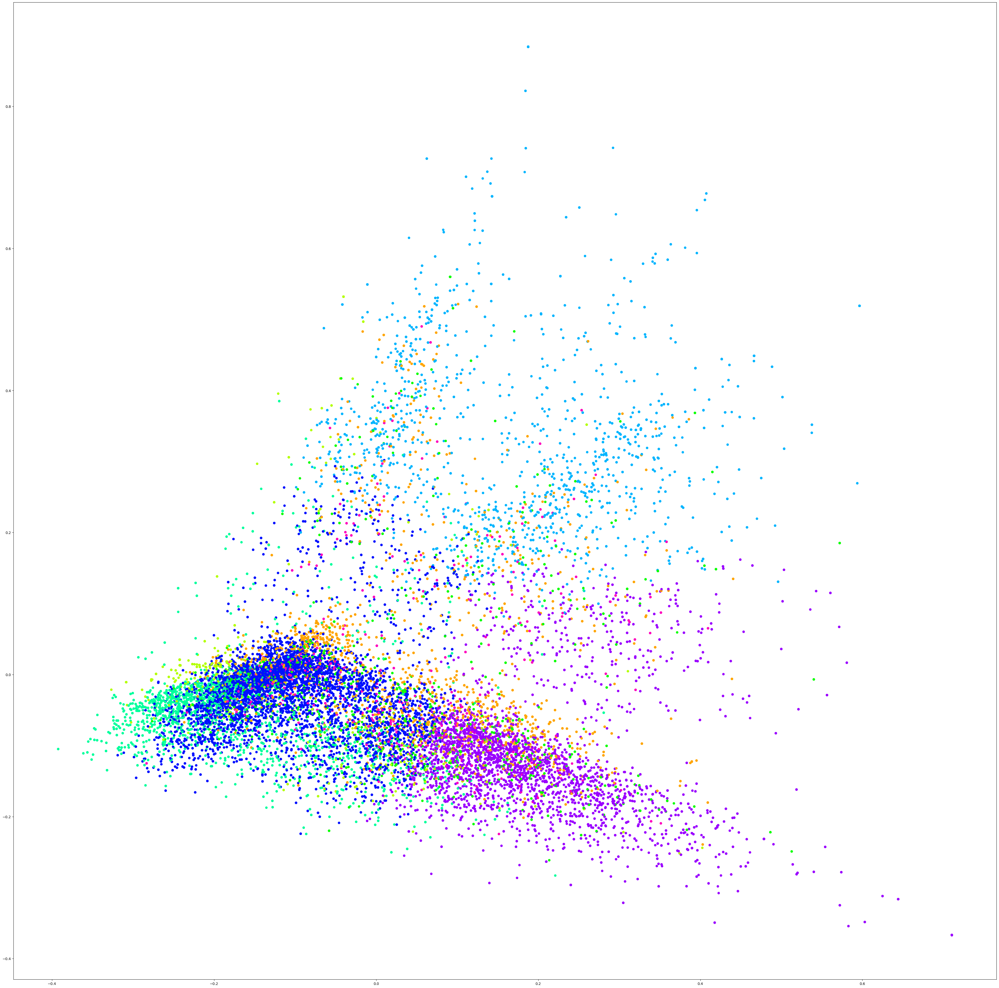

In [139]:
for i in range(5,21):
    predict(i)

In [ ]:

import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [134]:
kmean_indices = model.fit_predict(vectors)

pca = PCA(n_components=2)
scatter_plot_points = pca.fit_transform(vectors.toarray())

In [ ]:
colors = ["r", "b", "m", "y", "c"]

x_axis = [o[0] for o in scatter_plot_points]
y_axis = [o[1] for o in scatter_plot_points]

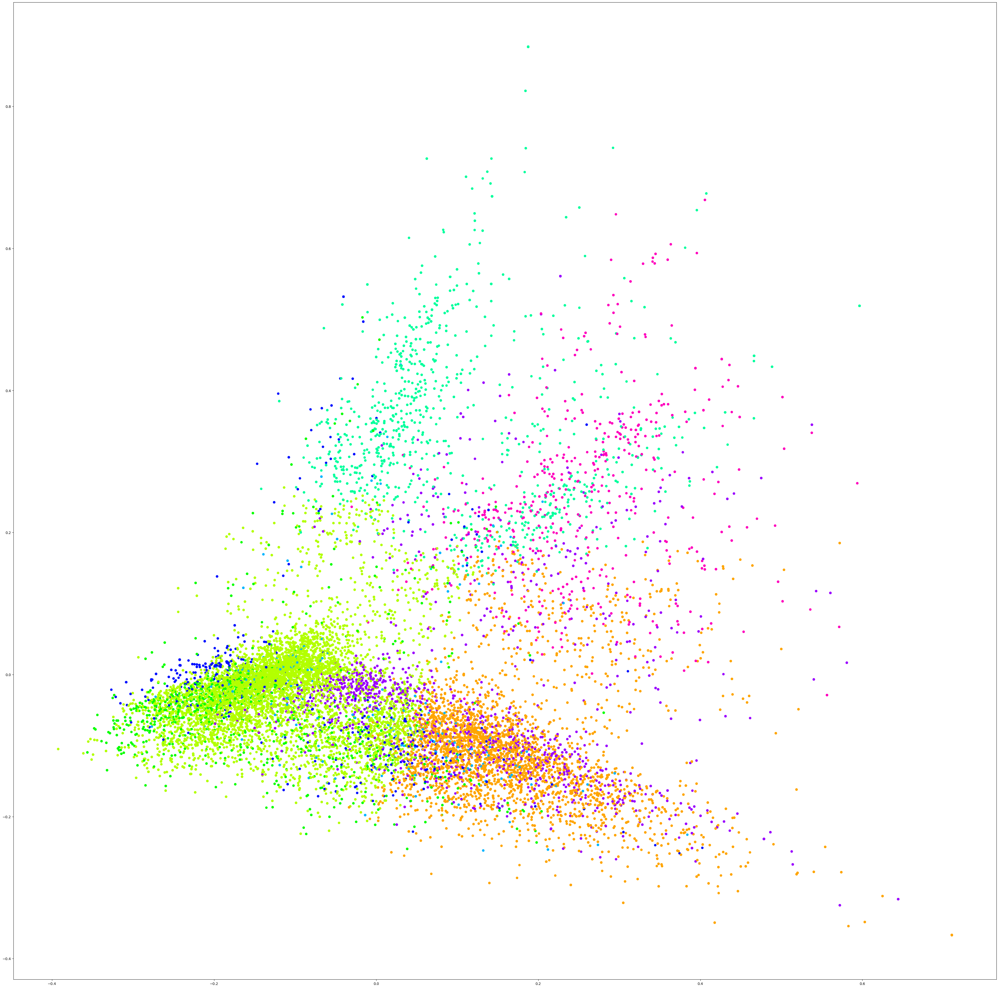

In [136]:
import matplotlib.pyplot as plt
import seaborn as sns

# Automatically generate distinct colors using seaborn
num_clusters = len(set(kmean_indices))
colors = sns.color_palette("hsv", num_clusters)

fig, ax = plt.subplots(figsize=(50, 50))
ax.scatter(x_axis, y_axis, c=[colors[d] for d in kmean_indices])
fig.savefig("kmeans_clusters.png")